<center> <h1>Analisis Pengaruh Indikator Makroekonomi dan Data Pasar Global terhadap Pergerakan Harga Bitcoin</h1>


This code is made by Rafael Hartono (166) and Nabil Putra Yuan (126)

# REQUEST YOUR FRED KEY HERE

FRED API
https://fredaccount.stlouisfed.org/apikeys

In [ ]:
FRED_API_KEY = "CHANGE WITH YOUR API"

# DISCOVERING DATA
Collecting data from 3 different source and a bit cleaning NaN using ffill and bfill

## INSTALASI LIBRARY & PREPARATION

In [ ]:
%pip install fredapi

In [ ]:
%pip install openpyxl

In [ ]:
%pip install python-binance

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.6/139.6 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 315.5/315.5 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 16.0 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import requests
import os
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')
import time
import seaborn as sns
import matplotlib.pyplot as plt

import shutil

from fredapi import Fred
from binance.client import Client
from google.colab import drive

In [ ]:
if not os.path.exists('data'):
    os.makedirs('data')

## FRED

In [ ]:
today = datetime.now().strftime('%Y-%m-%d')
start='2018-01-01'
yesterday = (datetime.now() - timedelta(days=1)).strftime('%Y-%m-%d')
end=today
print(today)

2025-12-16


In [ ]:
D_date_range = pd.date_range(start, end, freq='D')
W_date_range = pd.date_range(start, end, freq='W')
M_date_range = pd.date_range(start, end, freq='M')
Q_date_range = pd.date_range(start, end, freq='Q')

In [ ]:
fred = Fred(api_key=FRED_API_KEY)



df_fred_D = pd.DataFrame(index=D_date_range)
df_fred_W = pd.DataFrame(index=W_date_range)
df_fred_M = pd.DataFrame(index=M_date_range)
df_fred_M.index = pd.to_datetime(df_fred_M.index).to_period('M')
df_fred_Q = pd.DataFrame(index=Q_date_range)
df_fred_Q.index = pd.to_datetime(df_fred_Q.index).to_period('Q')


In [ ]:


fred_daily_series = {
    'DTWEXBGS': 'Indeks_Dolar'
}


fred_month_series = {
    'FEDFUNDS': 'Suku_Bunga_AS',
    'CPIAUCSL': 'Inflasi_AS',
    'UNRATE': 'Pengangguran_AS',
    'PPIACO': 'PPI_AS',
    'RSXFS': 'Retail_Sales',
    'INDPRO': 'Industrial_Production',
    'HOUST': 'Housing_Starts',
    'M2SL': 'Money_Supply_M2'
}

fred_Q_series = {
    'GDP': 'GDP_AS'
}


for fred_code, col_name in fred_daily_series.items():
    try:
        print(f"{col_name}", end=' ')
        data = fred.get_series(fred_code, observation_start=start,
                              observation_end=yesterday)
        if len(data) > 0:
          df_fred_D[col_name] = data
          print(f"{len(data)} data")
        else:
            print("kosong")
    except Exception as e:
        print("gagal")



for fred_code, col_name in fred_month_series.items():
    try:
        print(f"{col_name}", end=' ')
        data = fred.get_series(fred_code, observation_start=start,
                              observation_end=yesterday)
        data.index=pd.to_datetime(data.index).to_period('M')

        if len(data) > 0:
            df_fred_M[col_name] = data
            print(f"{len(data)} data")
        else:
            print("kosong")
    except Exception as e:
        print("gagal")


for fred_code, col_name in fred_Q_series.items():
    try:
        print(f"{col_name}", end=' ')
        data = fred.get_series(fred_code, observation_start=start,
                              observation_end=yesterday)
        data.index=pd.to_datetime(data.index).to_period('Q')
        if len(data) > 0:
            df_fred_Q[col_name] = data
            print(f"{len(data)} data")
        else:
            print("kosong")
    except Exception as e:
        print("gagal")

Indeks_Dolar 2075 data
Suku_Bunga_AS 95 data
Inflasi_AS 93 data
Pengangguran_AS 93 data
PPI_AS 93 data
Retail_Sales 93 data
Industrial_Production 93 data
Housing_Starts 92 data
Money_Supply_M2 94 data
GDP_AS 30 data


In [ ]:
print("\n","="*5,"DAILY","="*5,"\n",df_fred_D)
print("\n","="*5,"MONTH","="*5,"\n",df_fred_M)
print("\n","="*5,"QUARTAL","="*5,"\n",df_fred_Q)


 ===== DAILY ===== 
             Indeks_Dolar
2018-01-01           NaN
2018-01-02      109.6444
2018-01-03      109.6751
2018-01-04      109.4779
2018-01-05      109.3496
...                  ...
2025-12-12      120.5383
2025-12-13           NaN
2025-12-14           NaN
2025-12-15           NaN
2025-12-16           NaN

[2907 rows x 1 columns]

 ===== MONTH ===== 
          Suku_Bunga_AS  Inflasi_AS  Pengangguran_AS   PPI_AS  Retail_Sales  \
2018-01           1.41     248.859              4.0  197.900      423202.0   
2018-02           1.42     249.529              4.1  199.300      425507.0   
2018-03           1.51     249.577              4.0  199.300      425087.0   
2018-04           1.69     250.227              4.0  200.300      425899.0   
2018-05           1.70     250.792              3.8  203.200      432340.0   
...                ...         ...              ...      ...           ...   
2025-07           4.33     322.132              4.2  262.363      628747.0   
2025-08

In [ ]:
df_fred_D.head(30)

,Indeks_Dolar
2018-01-01,NaN
2018-01-02,109.6444
2018-01-03,109.6751
2018-01-04,109.4779
2018-01-05,109.3496
2018-01-06,NaN
2018-01-07,NaN
2018-01-08,109.5678
2018-01-09,109.9022
2018-01-10,109.6277


In [ ]:
for col in df_fred_D.columns:
  df_fred_D[col] = df_fred_D[col].fillna(method='ffill')
  if pd.isnull(df_fred_D[col].iloc[0]):
    df_fred_D[col] = df_fred_D[col].fillna(method='bfill')

df_fred_D.head(30)

,Indeks_Dolar
2018-01-01,109.6444
2018-01-02,109.6444
2018-01-03,109.6751
2018-01-04,109.4779
2018-01-05,109.3496
2018-01-06,109.3496
2018-01-07,109.3496
2018-01-08,109.5678
2018-01-09,109.9022
2018-01-10,109.6277


## YAHOO FINANCE

In [ ]:
df_yf = pd.DataFrame(index=D_date_range)

print("\n MENGAMBIL DATA DARI YAHOO FINANCE")

yf_t = {
    'GC=F': 'Emas_USD',
    'SI=F': 'Perak_USD',
    'CL=F': 'Minyak_WTI',

    '^GSPC': 'SP500',
    '^DJI': 'Dow_Jones',
    '^IXIC': 'Nasdaq',


    'USDIDR=X': 'USD_IDR',

}


successful_downloads = 0
for ticker, name in yf_t.items():
    try:
        print(f" {name}", end=' ')
        data = yf.download(ticker, start, end,
                          progress=False, auto_adjust=True, timeout=1000)
        if not data.empty:
            df_yf[name] = data['Close']
            print(f" {len(data)} data")
            successful_downloads += 1
        else:
            print(" kosong")
    except Exception as e:
        print(f" gagal")

print(f"\n Berhasil mengunduh {successful_downloads} dari {len(yf_t)} assets")




 MENGAMBIL DATA DARI YAHOO FINANCE
 Emas_USD  2001 data
 Perak_USD  2001 data
 Minyak_WTI  2002 data
 SP500  2000 data
 Dow_Jones  2000 data
 Nasdaq  2000 data
 USD_IDR  2072 data

 Berhasil mengunduh 7 dari 7 assets


In [ ]:
df_yf.head(30)

,Emas_USD,Perak_USD,Minyak_WTI,SP500,Dow_Jones,Nasdaq,USD_IDR
2018-01-01,NaN,NaN,NaN,NaN,NaN,NaN,13542.0
2018-01-02,1313.699951,17.121000,60.369999,2695.810059,24824.009766,7006.899902,13550.0
2018-01-03,1316.199951,17.184999,61.630001,2713.060059,24922.679688,7065.529785,13496.0
2018-01-04,1319.400024,17.188999,62.009998,2723.989990,25075.130859,7077.910156,13468.0
2018-01-05,1320.300049,17.205000,61.439999,2743.149902,25295.869141,7136.560059,13415.0
2018-01-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-01-08,1318.599976,17.063999,61.730000,2747.709961,25283.000000,7157.390137,13427.0
2018-01-09,1311.699951,16.936001,62.959999,2751.290039,25385.800781,7163.580078,13427.0
2018-01-10,1317.400024,16.962999,63.570000,2748.229980,25369.130859,7153.569824,13430.0


In [ ]:
for col in df_yf.columns:
  df_yf[col] = df_yf[col].fillna(method='ffill')
  if pd.isnull(df_yf[col].iloc[0]):
    df_yf[col] = df_yf[col].fillna(method='bfill')

df_yf.head(30)

,Emas_USD,Perak_USD,Minyak_WTI,SP500,Dow_Jones,Nasdaq,USD_IDR
2018-01-01,1313.699951,17.121000,60.369999,2695.810059,24824.009766,7006.899902,13542.0
2018-01-02,1313.699951,17.121000,60.369999,2695.810059,24824.009766,7006.899902,13550.0
2018-01-03,1316.199951,17.184999,61.630001,2713.060059,24922.679688,7065.529785,13496.0
2018-01-04,1319.400024,17.188999,62.009998,2723.989990,25075.130859,7077.910156,13468.0
2018-01-05,1320.300049,17.205000,61.439999,2743.149902,25295.869141,7136.560059,13415.0
2018-01-06,1320.300049,17.205000,61.439999,2743.149902,25295.869141,7136.560059,13415.0
2018-01-07,1320.300049,17.205000,61.439999,2743.149902,25295.869141,7136.560059,13415.0
2018-01-08,1318.599976,17.063999,61.730000,2747.709961,25283.000000,7157.390137,13427.0
2018-01-09,1311.699951,16.936001,62.959999,2751.290039,25385.800781,7163.580078,13427.0
2018-01-10,1317.400024,16.962999,63.570000,2748.229980,25369.130859,7153.569824,13430.0


In [ ]:
print(df_yf.isnull().sum())
print('baris teratas',df_yf.head(1))
print('baris terakhir',df_yf.tail(1))

Emas_USD      0
Perak_USD     0
Minyak_WTI    0
SP500         0
Dow_Jones     0
Nasdaq        0
USD_IDR       0
dtype: int64
baris teratas                Emas_USD  Perak_USD  Minyak_WTI        SP500     Dow_Jones  \
2018-01-01  1313.699951     17.121   60.369999  2695.810059  24824.009766   

                 Nasdaq  USD_IDR  
2018-01-01  7006.899902  13542.0  
baris terakhir                Emas_USD  Perak_USD  Minyak_WTI        SP500     Dow_Jones  \
2025-12-16  4316.399902      62.73       56.52  6816.509766  48416.558594   

                  Nasdaq       USD_IDR  
2025-12-16  23057.410156  16623.099609  


## BINANCE

In [ ]:

client = Client(tld='us')

DAFTAR_KOIN ={
        "BTCUSDT": "Bitcoin",
        "ETHUSDT": "Ethereum",
        "BNBUSDT": "BNB",
        "SOLUSDT": "Solana",
        "DOGEUSDT": "Dogecoin",
        "ADAUSDT": "Cardano",
        "XLMUSDT": "Stellar_Lumens",
    }

list_dataframe = []


print("Mulai mengambil data")
for symbol, nama in DAFTAR_KOIN.items():
    try:
        print(f"Memproses {nama}", end=" ")

        klines = client.get_historical_klines(symbol, "1d", "1 Jan, 2018")

        if klines:

            df = pd.DataFrame(klines).iloc[:, [0, 4]]
            df.columns = ["tanggal", nama]
            df["tanggal"] = pd.to_datetime(df["tanggal"], unit="ms")
            df[nama] = df[nama].astype(float)
            df.set_index("tanggal", inplace=True)

            list_dataframe.append(df)
            print(f"Berhasil diambil. tangggal awal {df.index.min().date()} hingga {df.index.max().date()}  (Harga Terakhir: ${df[nama].iloc[-1]:.2f})")
        else:
            print("Kosong.")

        time.sleep(0.5)

    except Exception as e:
        print(f"Error: {e}")



df_binance = pd.concat(list_dataframe, axis=1).sort_index()

print('baris teratas',df_binance.head(1))
print('baris terakhir',df_binance.tail(1))

Mulai mengambil data
Memproses Bitcoin Berhasil diambil. tangggal awal 2019-09-23 hingga 2025-12-16  (Harga Terakhir: $85899.91)
Memproses Ethereum Berhasil diambil. tangggal awal 2019-09-23 hingga 2025-12-16  (Harga Terakhir: $2929.77)
Memproses BNB Berhasil diambil. tangggal awal 2019-09-23 hingga 2025-12-16  (Harga Terakhir: $853.52)
Memproses Solana Berhasil diambil. tangggal awal 2020-09-18 hingga 2025-12-16  (Harga Terakhir: $126.65)
Memproses Dogecoin Berhasil diambil. tangggal awal 2019-10-25 hingga 2025-12-16  (Harga Terakhir: $0.13)
Memproses Cardano Berhasil diambil. tangggal awal 2019-09-25 hingga 2025-12-16  (Harga Terakhir: $0.38)
Memproses Stellar_Lumens Berhasil diambil. tangggal awal 2019-09-25 hingga 2025-12-16  (Harga Terakhir: $0.22)
baris teratas             Bitcoin  Ethereum      BNB  Solana  Dogecoin  Cardano  \
tanggal                                                             
2019-09-23  9930.13    209.55  19.8787     NaN       NaN      NaN   

            St

# STRUCTURING DATA

In [ ]:
df_daily_merge=pd.concat([df_fred_D,df_yf,df_binance],axis=1)
print("1 Tanggal teratas",df_daily_merge.head(1))
print("1 Tanggal terakhir",df_daily_merge.tail(1))

1 Tanggal teratas             Indeks_Dolar     Emas_USD  Perak_USD  Minyak_WTI        SP500  \
2018-01-01      109.6444  1313.699951     17.121   60.369999  2695.810059   

               Dow_Jones       Nasdaq  USD_IDR  Bitcoin  Ethereum  BNB  \
2018-01-01  24824.009766  7006.899902  13542.0      NaN       NaN  NaN   

            Solana  Dogecoin  Cardano  Stellar_Lumens  
2018-01-01     NaN       NaN      NaN             NaN  
1 Tanggal terakhir             Indeks_Dolar     Emas_USD  Perak_USD  Minyak_WTI        SP500  \
2025-12-16      120.5383  4316.399902      62.73       56.52  6816.509766   

               Dow_Jones        Nasdaq       USD_IDR   Bitcoin  Ethereum  \
2025-12-16  48416.558594  23057.410156  16623.099609  85899.91   2929.77   

               BNB  Solana  Dogecoin  Cardano  Stellar_Lumens  
2025-12-16  853.52  126.65   0.12931   0.3807          0.2171  


In [ ]:
df_yf_to_month = df_yf.resample('M').mean()
df_yf_to_month.index = df_yf_to_month.index.to_period('M')
df_yf_to_month.head(1)

,Emas_USD,Perak_USD,Minyak_WTI,SP500,Dow_Jones,Nasdaq,USD_IDR
2018-01,1331.82581,17.126323,63.613226,2790.098397,25809.243637,7277.966419,13378.419355


In [ ]:
df_binance_to_month = df_binance.resample('M').mean()
df_binance_to_month.index = df_binance_to_month.index.to_period('M')
df_binance_to_month.head(1)

,Bitcoin,Ethereum,BNB,Solana,Dogecoin,Cardano,Stellar_Lumens
tanggal,,,,,,,
2019-09,8459.47,176.245,16.172875,NaN,NaN,0.03845,0.058513


In [ ]:
df_fred_D_to_M = df_fred_D.resample('M').mean()
df_fred_D_to_M.index = df_fred_D_to_M.index.to_period('M')

df_fred_M1=pd.concat([df_fred_M,df_fred_D_to_M],axis=1)
df_fred_M1.head(1)

,Suku_Bunga_AS,Inflasi_AS,Pengangguran_AS,PPI_AS,Retail_Sales,Industrial_Production,Housing_Starts,Money_Supply_M2,Indeks_Dolar
2018-01,1.41,248.859,4.0,197.9,423202.0,101.4625,1299.0,13882.9,108.380987


In [ ]:
df_month_merge=pd.concat([df_fred_M1,df_yf_to_month,df_binance_to_month],axis=1)
df_month_merge.shape

(96, 23)

In [ ]:
df_yf_to_Q = df_yf.resample('Q').mean()
df_yf_to_Q.index = df_yf_to_Q.index.to_period('Q')
df_yf_to_Q.shape

(32, 7)

In [ ]:
df_binance_to_Q = df_binance.resample('Q').mean()
df_binance_to_Q.index = df_binance_to_Q.index.to_period('Q')
df_binance_to_Q.shape

(26, 7)

In [ ]:

df_fred_D_to_Q = df_fred_D.resample('Q').mean()
df_fred_D_to_Q.index = df_fred_D_to_Q.index.to_period('Q')

df_fred_Q1=pd.concat([df_fred_Q,df_fred_D_to_Q],axis=1)


df_fred_M_to_Q = df_fred_M.resample('Q').mean()


df_fred_Q_gabungan = pd.concat([df_fred_Q1, df_fred_M_to_Q], axis=1)

print(df_fred_Q_gabungan.shape)

(32, 10)


In [ ]:
df_Q_merge=pd.concat([df_fred_Q_gabungan,df_yf_to_Q,df_binance_to_Q],axis=1)
print(df_Q_merge.shape)

(32, 24)


In [ ]:
df_daily_clean= df_daily_merge
df_daily_change = df_daily_clean.pct_change().dropna()

print("=== DATA PERUBAHAN HARIAN ===")
print(f"Shape: {df_daily_change.shape}")

periode_hari_awal = df_daily_change.index.min().strftime('%Y-%m-%d')
periode_hari_akhir = df_daily_change.index.max().strftime('%Y-%m-%d')
print(f"Periode: {periode_hari_awal} - {periode_hari_akhir}")


print(f"Total hari: {len(df_daily_change)}")

print("\n5 Data perubahan teratas:")
print(df_daily_change.head())
print("\n5 Data perubahan terakhir:")
print(df_daily_change.tail())

print("\nStatistik perubahan:")
print(df_daily_change.describe())

=== DATA PERUBAHAN HARIAN ===
Shape: (1915, 15)
Periode: 2020-09-19 - 2025-12-16
Total hari: 1915

5 Data perubahan teratas:
            Indeks_Dolar  Emas_USD  Perak_USD  Minyak_WTI     SP500  \
2020-09-19      0.000000  0.000000   0.000000    0.000000  0.000000   
2020-09-20      0.000000  0.000000   0.000000    0.000000  0.000000   
2020-09-21      0.009886 -0.026074  -0.100969   -0.043785 -0.011571   
2020-09-22      0.001423 -0.001368   0.005885    0.007377  0.010518   
2020-09-23      0.006093 -0.020383  -0.058424    0.008333 -0.023721   

            Dow_Jones    Nasdaq   USD_IDR   Bitcoin  Ethereum       BNB  \
2020-09-19   0.000000  0.000000  0.000000  0.013309  0.005425 -0.018477   
2020-09-20   0.000000  0.000000  0.000000 -0.015034 -0.037456 -0.030305   
2020-09-21  -0.018430 -0.001342 -0.004057 -0.044243 -0.083729 -0.124755   
2020-09-22   0.005175  0.017148  0.007550  0.008649  0.011647  0.043097   
2020-09-23  -0.019241 -0.030159 -0.006511 -0.027487 -0.067971 -0.052550  

In [ ]:
df_month_clean= df_month_merge.dropna()
df_month_change = df_month_clean.pct_change().dropna()

print("=== DATA PERUBAHAN BULANAN ===")
print(f"Shape: {df_month_change.shape}")

periode_bulan_awal = df_month_change.index.min().strftime('%Y-%m')
periode_bulan_akhir = df_month_change.index.max().strftime('%Y-%m')
print(f"Periode: {periode_bulan_awal} - {periode_bulan_akhir}")


print(f"Total month: {len(df_month_change)}")

print("\n5 Data perubahan teratas:")
print(df_month_change.head())
print("\n5 Data perubahan terakhir:")
print(df_month_change.tail())

print("\nStatistik perubahan:")
print(df_month_change.describe())

=== DATA PERUBAHAN BULANAN ===
Shape: (59, 23)
Periode: 2020-10 - 2025-08
Total month: 59

5 Data perubahan teratas:
         Suku_Bunga_AS  Inflasi_AS  Pengangguran_AS    PPI_AS  Retail_Sales  \
2020-10       0.000000    0.001238        -0.115385  0.005115     -0.004017   
2020-11       0.000000    0.002274        -0.028986  0.009160     -0.005583   
2020-12       0.000000    0.004346         0.000000  0.011094      0.016462   
2021-01       0.000000    0.002267        -0.044776  0.021446      0.032215   
2021-02      -0.111111    0.003556        -0.031250  0.028320     -0.025516   

         Industrial_Production  Housing_Starts  Money_Supply_M2  Indeks_Dolar  \
2020-10               0.008050        0.047522         0.008319     -0.004912   
2020-11               0.003537        0.000000         0.012149     -0.015134   
2020-12               0.013199        0.046014         0.008120     -0.018467   
2021-01               0.005278        0.009913         0.011838     -0.003609   
202

In [ ]:
df_Q_clean= df_Q_merge.dropna()
df_Q_change = df_Q_clean.pct_change().dropna()

print("=== DATA PERUBAHAN KUARTAL ===")
print(f"Shape: {df_Q_change.shape}")

periode_kuartal_awal = df_Q_change.index.min().strftime('%YQ%q')
periode_kuartal_akhir = df_Q_change.index.max().strftime('%YQ%q')
print(f"Periode: {periode_kuartal_awal} - {periode_kuartal_akhir}")

print(f"Total kuartal: {len(df_Q_change)}")

print("\n5 Data perubahan teratas:")
print(df_Q_change.head())
print("\n5 Data perubahan terakhir:")
print(df_Q_change.tail())

print("\nStatistik perubahan:")
print(df_Q_change.describe())

=== DATA PERUBAHAN KUARTAL ===
Shape: (19, 24)
Periode: 2020Q4 - 2025Q2
Total kuartal: 19

5 Data perubahan teratas:
          GDP_AS  Indeks_Dolar  Suku_Bunga_AS  Inflasi_AS  Pengangguran_AS  \
2020Q4  0.017633     -0.029822      -0.035714    0.007214        -0.231061   
2021Q1  0.026872     -0.013941      -0.111111    0.009938        -0.078818   
2021Q2  0.032857     -0.004119      -0.125000    0.018557        -0.048128   
2021Q3  0.023754      0.012762       0.285714    0.016035        -0.146067   
2021Q4  0.034660      0.015161      -0.111111    0.021375        -0.171053   

          PPI_AS  Retail_Sales  Industrial_Production  Housing_Starts  \
2020Q4  0.021448      0.011566               0.018249        0.069397   
2021Q1  0.058962      0.058988               0.002391        0.006383   
2021Q2  0.065514      0.058120               0.016758        0.000846   
2021Q3  0.043536     -0.013102               0.004576        0.007182   
2021Q4  0.034449      0.028786               0.00

# VISUALIZATION

## TIME SERIES

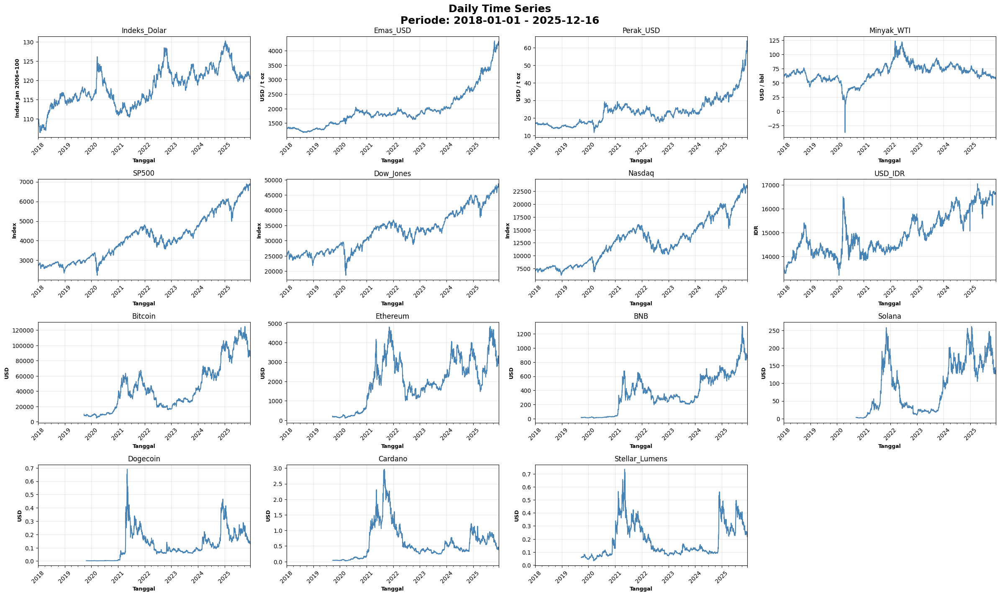

In [ ]:
import matplotlib.pyplot as plt



satuan_map = {

    'Suku_Bunga_AS': 'Percent (%)',
    'Inflasi_AS': 'Index 1982-1984=100',
    'Pengangguran_AS': 'Percent (%)',


    'GDP_AS': 'Billions USD',
    'Money_Supply_M2': 'Billions of USD',
    'Retail_Sales': 'Millions of USD',


    'PPI_AS': 'Index 1982=100',
    'Industrial_Production': 'Index 2017=100 ',
    'Housing_Starts': 'Thousands of Units',

    'Indeks_Dolar': 'Index Jan 2006=100 ',


    'SP500': 'Index',
    'Dow_Jones': 'Index',
    'Nasdaq': 'Index',

    'Emas_USD': 'USD / t oz',
    'Perak_USD': 'USD / t oz',
    'Minyak_WTI': 'USD / bbl',

    'USD_IDR': 'IDR',

    'Bitcoin': 'USD',
    'Ethereum': 'USD',
    'BNB': 'USD',
    'Solana': 'USD',
    'Dogecoin': 'USD',
    'Cardano': 'USD',
    'Stellar_Lumens': 'USD'
}




fig, axes = plt.subplots(6, 4, figsize=(24, 20))
axes = axes.flatten()

for i, column in enumerate(df_daily_merge.columns):
    if i < len(axes):

        df_daily_merge[column].plot(ax=axes[i], title=column, color='steelblue')


        y_label = satuan_map.get(column, 'Nilai')


        axes[i].set_ylabel(y_label, fontsize=9, fontweight='bold')
        axes[i].set_xlabel('Tanggal', fontsize=9, fontweight='bold')


        axes[i].tick_params(axis='x', rotation=45)
        axes[i].grid(True, alpha=0.3)


for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()


plt.suptitle(f'Daily Time Series\nPeriode: {df_daily_merge.index.min().date()} - {df_daily_merge.index.max().date()}',
             fontsize=18, fontweight='bold', y=1.02)

plt.savefig('daily_time_series.png', bbox_inches='tight')
plt.show()

Data shape: (96, 23)
Columns: ['Suku_Bunga_AS', 'Inflasi_AS', 'Pengangguran_AS', 'PPI_AS', 'Retail_Sales', 'Industrial_Production', 'Housing_Starts', 'Money_Supply_M2', 'Indeks_Dolar', 'Emas_USD', 'Perak_USD', 'Minyak_WTI', 'SP500', 'Dow_Jones', 'Nasdaq', 'USD_IDR', 'Bitcoin', 'Ethereum', 'BNB', 'Solana', 'Dogecoin', 'Cardano', 'Stellar_Lumens']


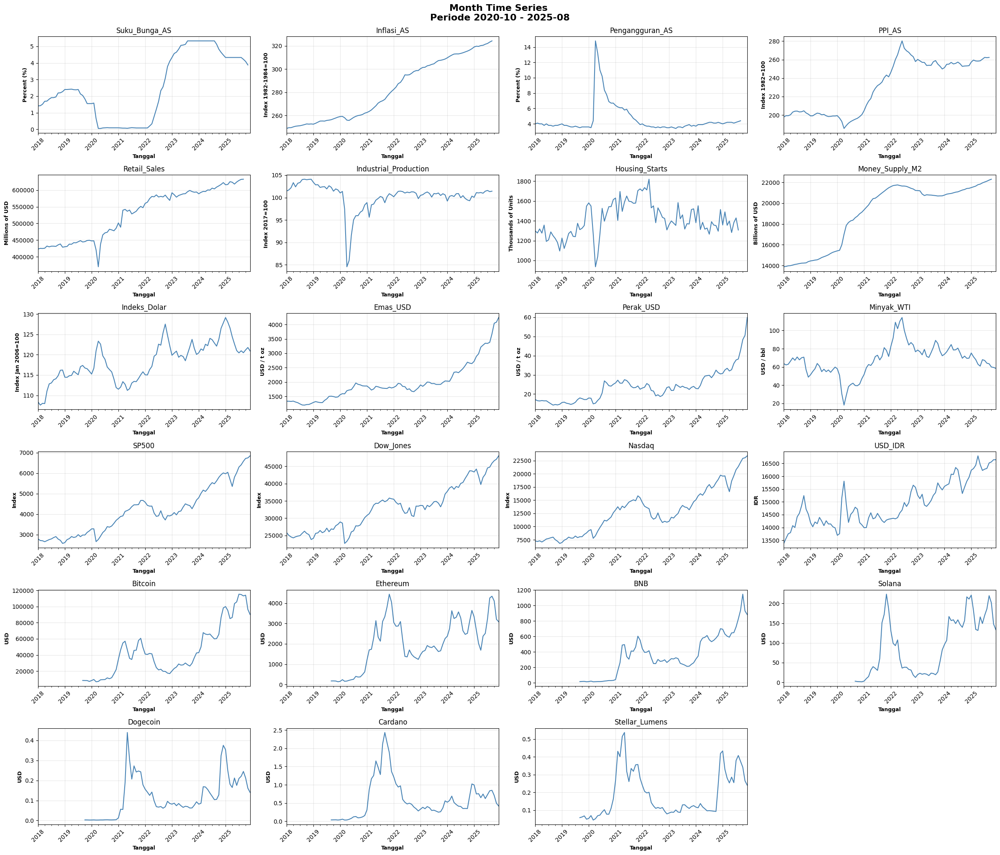

In [ ]:
print(f"Data shape: {df_month_merge.shape}")
print(f"Columns: {df_month_merge.columns.tolist()}")


fig, axes = plt.subplots(6, 4, figsize=(24, 20))
axes = axes.flatten()

for i, column in enumerate(df_month_merge.columns):
    if i < len(axes):

        df_month_merge[column].plot(ax=axes[i], title=column, color='steelblue')


        y_label = satuan_map.get(column, 'Nilai')


        axes[i].set_ylabel(y_label, fontsize=9, fontweight='bold')
        axes[i].set_xlabel('Tanggal', fontsize=9, fontweight='bold')


        axes[i].tick_params(axis='x', rotation=45)
        axes[i].grid(True, alpha=0.3)


for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()

plt.suptitle(f'Month Time Series \nPeriode {periode_bulan_awal} - {periode_bulan_akhir}', fontsize=16, y=1.02, fontweight='bold')
plt.savefig('month_time_series.png')
plt.show()

Data shape: (32, 24)
Columns: ['GDP_AS', 'Indeks_Dolar', 'Suku_Bunga_AS', 'Inflasi_AS', 'Pengangguran_AS', 'PPI_AS', 'Retail_Sales', 'Industrial_Production', 'Housing_Starts', 'Money_Supply_M2', 'Emas_USD', 'Perak_USD', 'Minyak_WTI', 'SP500', 'Dow_Jones', 'Nasdaq', 'USD_IDR', 'Bitcoin', 'Ethereum', 'BNB', 'Solana', 'Dogecoin', 'Cardano', 'Stellar_Lumens']


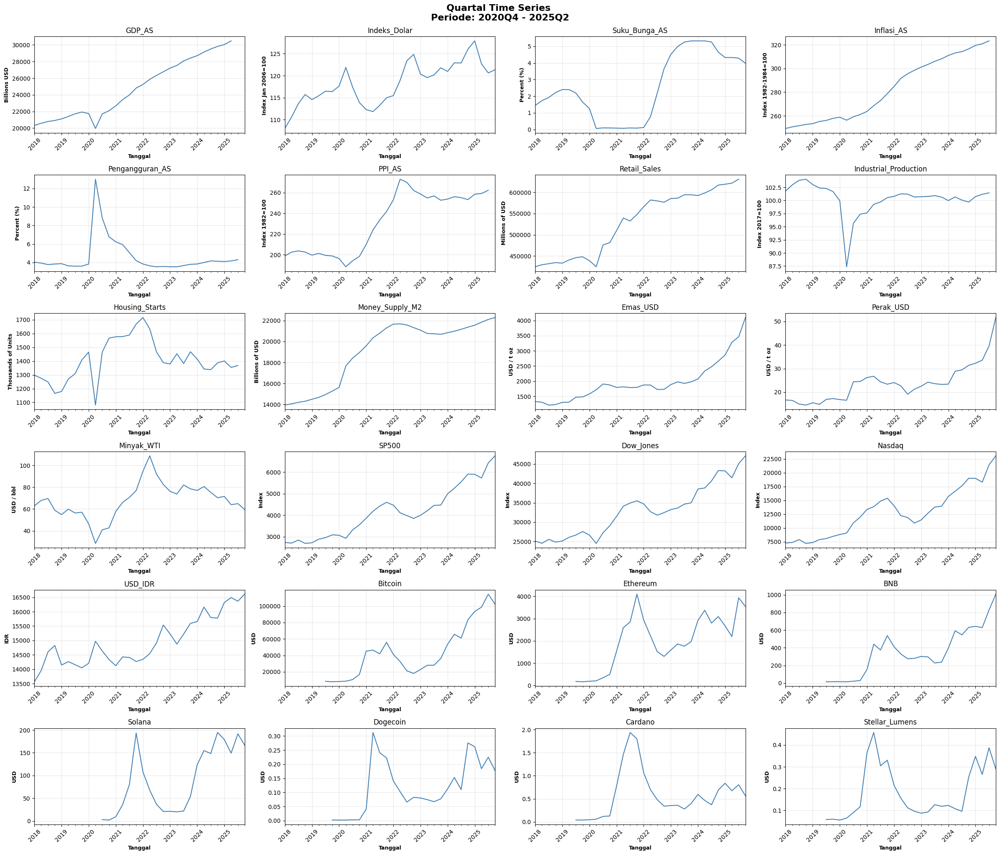

In [ ]:
print(f"Data shape: {df_Q_merge.shape}")
print(f"Columns: {df_Q_merge.columns.tolist()}")


fig, axes = plt.subplots(6, 4, figsize=(24, 20))
axes = axes.flatten()

for i, column in enumerate(df_Q_merge.columns):
    if i < len(axes):

        df_Q_merge[column].plot(ax=axes[i], title=column, color='steelblue')


        y_label = satuan_map.get(column, 'Nilai')


        axes[i].set_ylabel(y_label, fontsize=9, fontweight='bold')
        axes[i].set_xlabel('Tanggal', fontsize=9, fontweight='bold')


        axes[i].tick_params(axis='x', rotation=45)
        axes[i].grid(True, alpha=0.3)


for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()

plt.suptitle(f'Quartal Time Series \nPeriode: {periode_kuartal_awal} - {periode_kuartal_akhir}', fontsize=16, y=1.02, fontweight='bold')
plt.savefig('Q_time_series.png')
plt.show()

## PERCENTAGE CHANGE

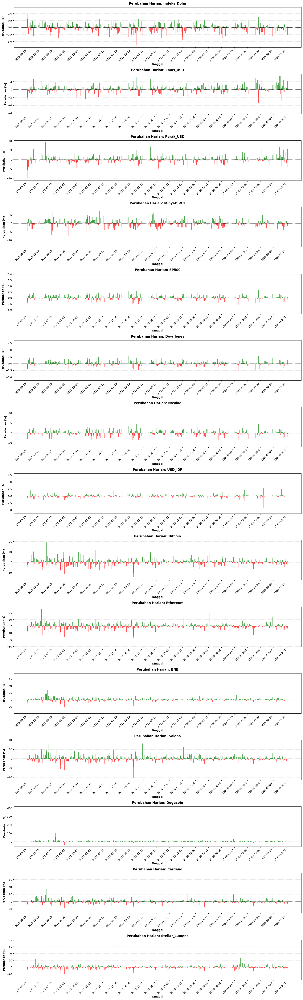

In [ ]:
n_cols = df_daily_change.shape[1]
fig_height = 3.5 * n_cols
fig, axes = plt.subplots(n_cols, 1, figsize=(16, fig_height))

if n_cols == 1:
    axes = [axes]

for i, col in enumerate(df_daily_change.columns):
    ax = axes[i]
    series = df_daily_change[col]


    series_persen = series * 100


    colors = np.where(series_persen.values >= 0, 'green', 'red')


    ax.bar(series_persen.index, series_persen.values,
           color=colors, width=1.0, alpha=0.7)


    ax.axhline(0, color='black', linestyle='--', linewidth=0.8)


    ax.set_title(f'Perubahan Harian: {col}',
                 fontsize=12, fontweight='bold', pad=10)


    ax.set_ylabel('Perubahan (%)', fontweight='bold')
    ax.set_xlabel('Tanggal', fontweight = 'bold')
    ax.grid(axis='y', linestyle='--', alpha=0.3)


    ax.tick_params(axis='x', rotation=45)


    if len(series_persen) > 100:
        dates = series_persen.index
        step = max(1, len(dates) // 20)
        tick_positions = range(0, len(dates), step)
        tick_labels = [dates[i].strftime('%Y-%m-%d') for i in tick_positions]

        ax.set_xticks([dates[i] for i in tick_positions])
        ax.set_xticklabels(tick_labels, rotation=45, ha='right')

plt.tight_layout()
plt.savefig('perubahan_harian.png', dpi=200, bbox_inches='tight')
plt.show()

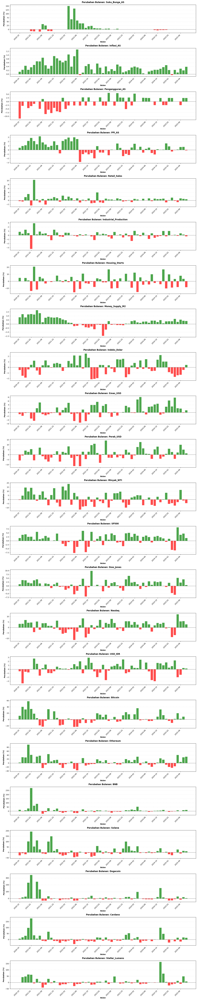

In [ ]:
n_cols = df_month_change.shape[1]
fig_height = 3.5 * n_cols
fig, axes = plt.subplots(n_cols, 1, figsize=(16, fig_height))

if n_cols == 1:
    axes = [axes]

for i, col in enumerate(df_month_change.columns):
    ax = axes[i]
    series = df_month_change[col]


    series_persen = series * 100


    colors = np.where(series_persen.values >= 0, 'green', 'red')


    x_labels = series_persen.index.strftime('%Y-%m')
    x_positions = range(len(x_labels))


    ax.bar(x_positions, series_persen.values,
           color=colors, width=0.8, alpha=0.7)


    ax.axhline(0, color='black', linestyle='--', linewidth=0.8)


    ax.set_title(f'Perubahan Bulanan: {col}',
                 fontsize=12, fontweight='bold', pad=10)


    ax.set_ylabel('Perubahan (%)' , fontweight='bold')
    ax.set_xlabel('Bulan', fontweight='bold')
    ax.grid(axis='y', linestyle='--', alpha=0.3)


    ax.set_xticks(x_positions)
    ax.set_xticklabels(x_labels, rotation=45, ha='right')


    if len(series_persen) > 24:
        step = max(1, len(x_labels) // 12)
        tick_positions = range(0, len(x_labels), step)
        tick_labels = [x_labels[i] for i in tick_positions]

        ax.set_xticks(tick_positions)
        ax.set_xticklabels(tick_labels, rotation=45, ha='right')

plt.tight_layout()
plt.savefig('perubahan_bulanan.png', dpi=200, bbox_inches='tight')
plt.show()

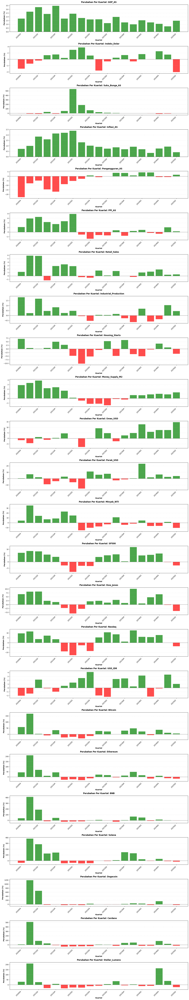

In [ ]:
n_cols = df_Q_change.shape[1]
fig_height = 3.5 * n_cols
fig, axes = plt.subplots(n_cols, 1, figsize=(16, fig_height))

if n_cols == 1:
    axes = [axes]

for i, col in enumerate(df_Q_change.columns):
    ax = axes[i]
    series = df_Q_change[col]


    series_persen = series * 100


    colors = np.where(series_persen.values >= 0, 'green', 'red')


    if hasattr(series_persen.index, 'quarter'):

        x_labels = [f'{year}Q{q}' for year, q in zip(series_persen.index.year,
                                                     series_persen.index.quarter)]
    else:

        x_labels = series_persen.index.astype(str)

    x_positions = range(len(x_labels))


    ax.bar(x_positions, series_persen.values,
           color=colors, width=0.8, alpha=0.7)


    ax.axhline(0, color='black', linestyle='--', linewidth=0.8)


    ax.set_title(f'Perubahan Per Kuartal: {col}',
                 fontsize=12, fontweight='bold', pad=10)


    ax.set_ylabel('Perubahan (%)', fontweight='bold')
    ax.set_xlabel('Kuartal', fontweight='bold')
    ax.grid(axis='y', linestyle='--', alpha=0.3)


    ax.set_xticks(x_positions)
    ax.set_xticklabels(x_labels, rotation=45, ha='right')


    if len(series_persen) > 16:
        step = max(1, len(x_labels) // 8)
        tick_positions = range(0, len(x_labels), step)
        tick_labels = [x_labels[i] for i in tick_positions]

        ax.set_xticks(tick_positions)
        ax.set_xticklabels(tick_labels, rotation=45, ha='right')

plt.tight_layout()
plt.savefig('perubahan_kuartalan.png', dpi=200, bbox_inches='tight')
plt.show()

## CORRELATION MATRIX

=== CORRELATION MATRIX ===
Shape: (15, 15)

Matriks Korelasi:
                Indeks_Dolar  Emas_USD  Perak_USD  Minyak_WTI  SP500  \
Indeks_Dolar           1.000    -0.435     -0.433      -0.116 -0.273   
Emas_USD              -0.435     1.000      0.756       0.133  0.078   
Perak_USD             -0.433     0.756      1.000       0.185  0.207   
Minyak_WTI            -0.116     0.133      0.185       1.000  0.164   
SP500                 -0.273     0.078      0.207       0.164  1.000   
Dow_Jones             -0.266     0.058      0.182       0.177  0.919   
Nasdaq                -0.248     0.073      0.196       0.105  0.951   
USD_IDR                0.063    -0.005     -0.043       0.008  0.009   
Bitcoin               -0.162     0.056      0.122       0.061  0.337   
Ethereum              -0.165     0.056      0.131       0.074  0.345   
BNB                   -0.141     0.050      0.104       0.059  0.239   
Solana                -0.131     0.041      0.098       0.047  0.280   
Do

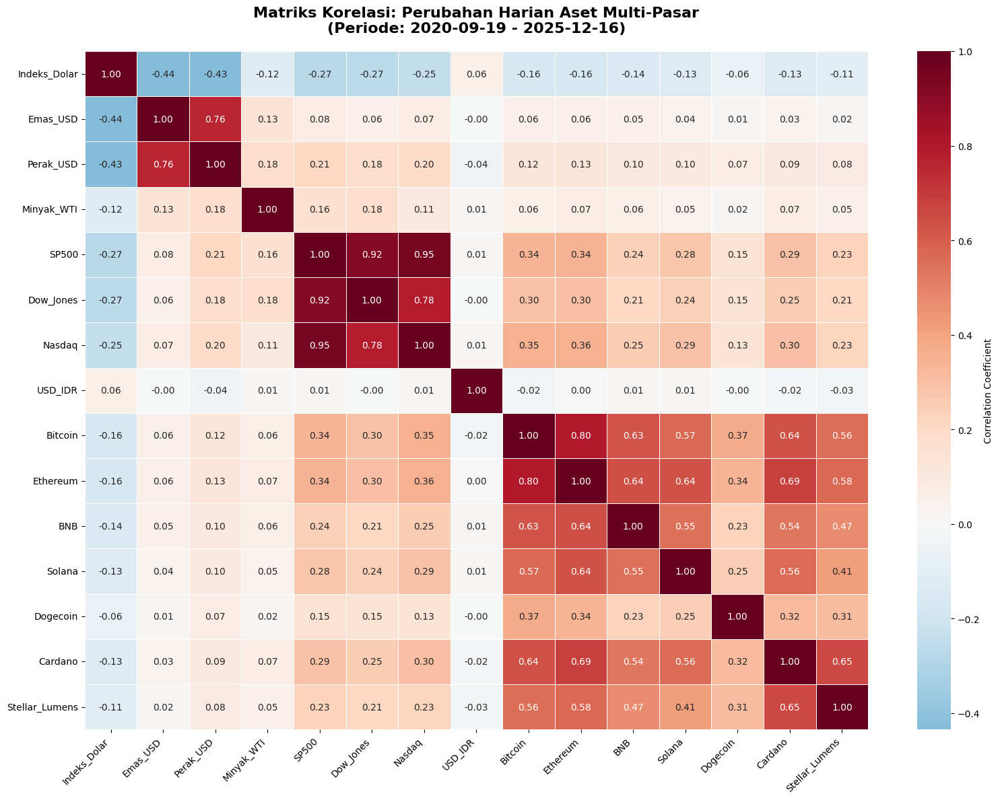

In [ ]:
correlation_matrix = df_daily_change.corr()

print("=== CORRELATION MATRIX ===")

print(f"Shape: {correlation_matrix.shape}")
print("\nMatriks Korelasi:")
print(correlation_matrix.round(3))

plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix,
            annot=True,
            cmap='RdBu_r',
            center=0,
            fmt='.2f',
            linewidths=0.5,
            cbar_kws={'label': 'Correlation Coefficient'})

plt.title(f'Matriks Korelasi: Perubahan Harian Aset Multi-Pasar\n(Periode: {periode_hari_awal} - {periode_hari_akhir})',
          fontsize=16, fontweight='bold', pad=20)

plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('correlation_matrix_daily.png')
plt.show()

=== CORRELATION MATRIX ===
Shape: (23, 23)

Matriks Korelasi:
                       Suku_Bunga_AS  Inflasi_AS  Pengangguran_AS  PPI_AS  \
Suku_Bunga_AS                  1.000       0.451           -0.008   0.264   
Inflasi_AS                     0.451       1.000           -0.193   0.682   
Pengangguran_AS               -0.008      -0.193            1.000  -0.196   
PPI_AS                         0.264       0.682           -0.196   1.000   
Retail_Sales                  -0.016       0.220            0.127   0.287   
Industrial_Production          0.019       0.163           -0.063   0.154   
Housing_Starts                -0.159      -0.011            0.033   0.015   
Money_Supply_M2               -0.280       0.165           -0.295   0.457   
Indeks_Dolar                   0.277       0.240            0.069   0.094   
Emas_USD                      -0.124      -0.095            0.064  -0.053   
Perak_USD                     -0.131      -0.086            0.088   0.031   
Minyak_WTI    

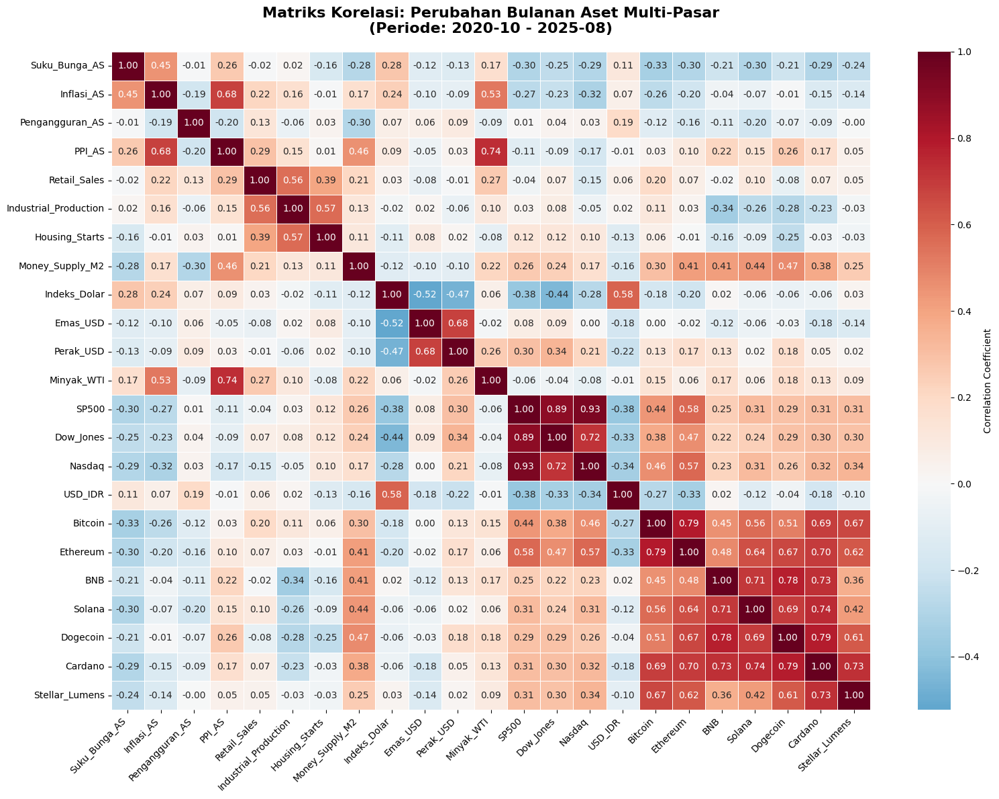

In [ ]:
correlation_matrix = df_month_change.corr()

print("=== CORRELATION MATRIX ===")

print(f"Shape: {correlation_matrix.shape}")
print("\nMatriks Korelasi:")
print(correlation_matrix.round(3))


plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix,
            annot=True,
            cmap='RdBu_r',
            center=0,
            fmt='.2f',
            linewidths=0.5,
            cbar_kws={'label': 'Correlation Coefficient'})

plt.title(f'Matriks Korelasi: Perubahan Bulanan Aset Multi-Pasar\n(Periode: {periode_bulan_awal} - {periode_bulan_akhir})',
          fontsize=16, fontweight='bold', pad=20)


plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('correlation_matrix_monthly.png')
plt.show()


=== CORRELATION MATRIX ===
Shape: (24, 24)

Matriks Korelasi:
                       GDP_AS  Indeks_Dolar  Suku_Bunga_AS  Inflasi_AS  \
GDP_AS                  1.000         0.052          0.173       0.679   
Indeks_Dolar            0.052         1.000          0.429       0.404   
Suku_Bunga_AS           0.173         0.429          1.000       0.532   
Inflasi_AS              0.679         0.404          0.532       1.000   
Pengangguran_AS        -0.552         0.109         -0.037      -0.497   
PPI_AS                  0.671         0.075          0.367       0.716   
Retail_Sales            0.627        -0.132          0.037       0.417   
Industrial_Production   0.470        -0.209         -0.039       0.308   
Housing_Starts          0.010        -0.256         -0.419      -0.019   
Money_Supply_M2         0.573        -0.187         -0.255       0.294   
Emas_USD               -0.495        -0.356         -0.283      -0.406   
Perak_USD              -0.286        -0.285       

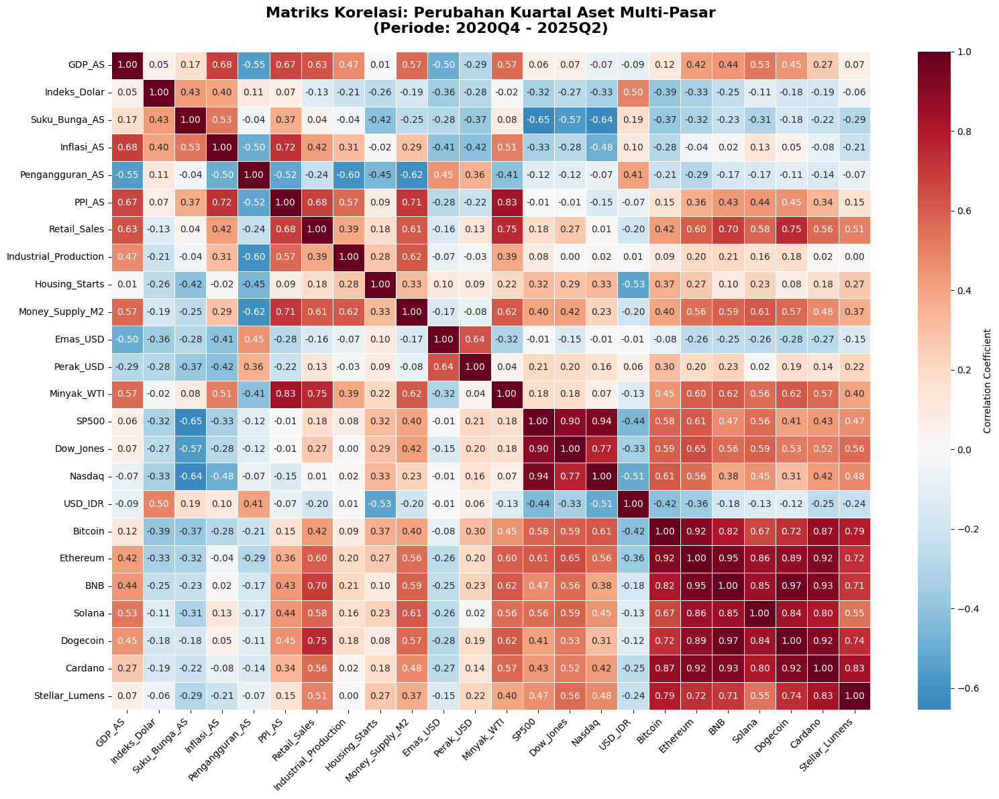

In [ ]:
correlation_matrix = df_Q_change.corr()

print("=== CORRELATION MATRIX ===")

print(f"Shape: {correlation_matrix.shape}")
print("\nMatriks Korelasi:")
print(correlation_matrix.round(3))


plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix,
            annot=True,
            cmap='RdBu_r',
            center=0,
            fmt='.2f',
            linewidths=0.5,
            cbar_kws={'label': 'Correlation Coefficient'})

plt.title(f'Matriks Korelasi: Perubahan Kuartal Aset Multi-Pasar\n(Periode: {periode_kuartal_awal} - {periode_kuartal_akhir})',
          fontsize=16, fontweight='bold', pad=20)

plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('correlation_matrix_quarterly.png')
plt.show()

## PAIRPLOT

=== PAIRPLOT PERUBAHAN HARIAN ===


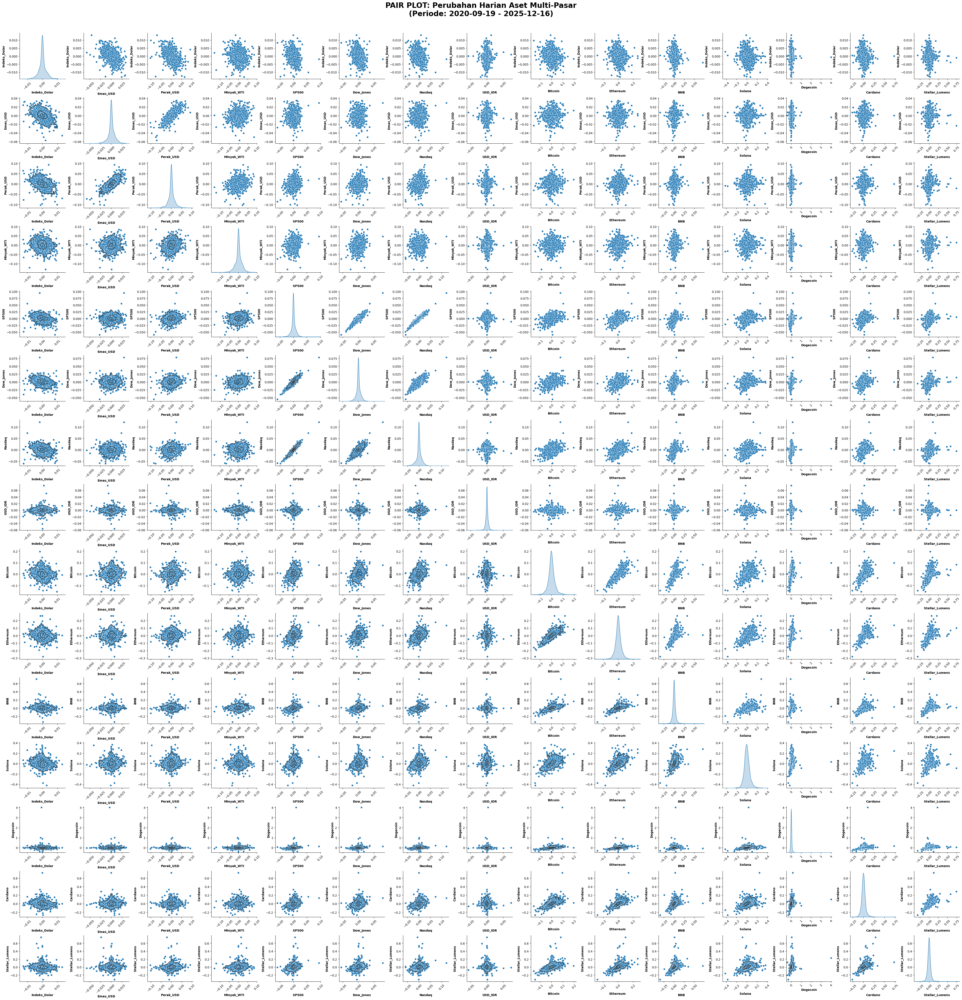

In [ ]:
print("=== PAIRPLOT PERUBAHAN HARIAN ===")

g = sns.pairplot(df_daily_change, diag_kind="kde", height=3)

g.map_lower(sns.kdeplot, levels=4, color=".2")

g.fig.suptitle(f'PAIR PLOT: Perubahan Harian Aset Multi-Pasar\n(Periode: {periode_hari_awal} - {periode_hari_akhir})',
               fontsize=24,
               fontweight='bold',
               y=1.02)

rows, cols = g.axes.shape

for i in range(rows):
    for j in range(cols):
        ax = g.axes[i, j]

        xlabel_text = g.x_vars[j]
        ylabel_text = g.y_vars[i]

        ax.set_xlabel(xlabel_text, fontsize=10, fontweight='bold')
        ax.set_ylabel(ylabel_text, fontsize=10, fontweight='bold')

        ax.xaxis.label.set_visible(True)
        ax.yaxis.label.set_visible(True)

        ax.tick_params(labelbottom=True, labelleft=True)
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', rotation=0)

plt.subplots_adjust(wspace=0.4, hspace=0.4)

plt.savefig('pair_plot_harian.png', bbox_inches='tight', dpi=200)

plt.show()

=== PAIRPLOT PERUBAHAN BULANAN ===


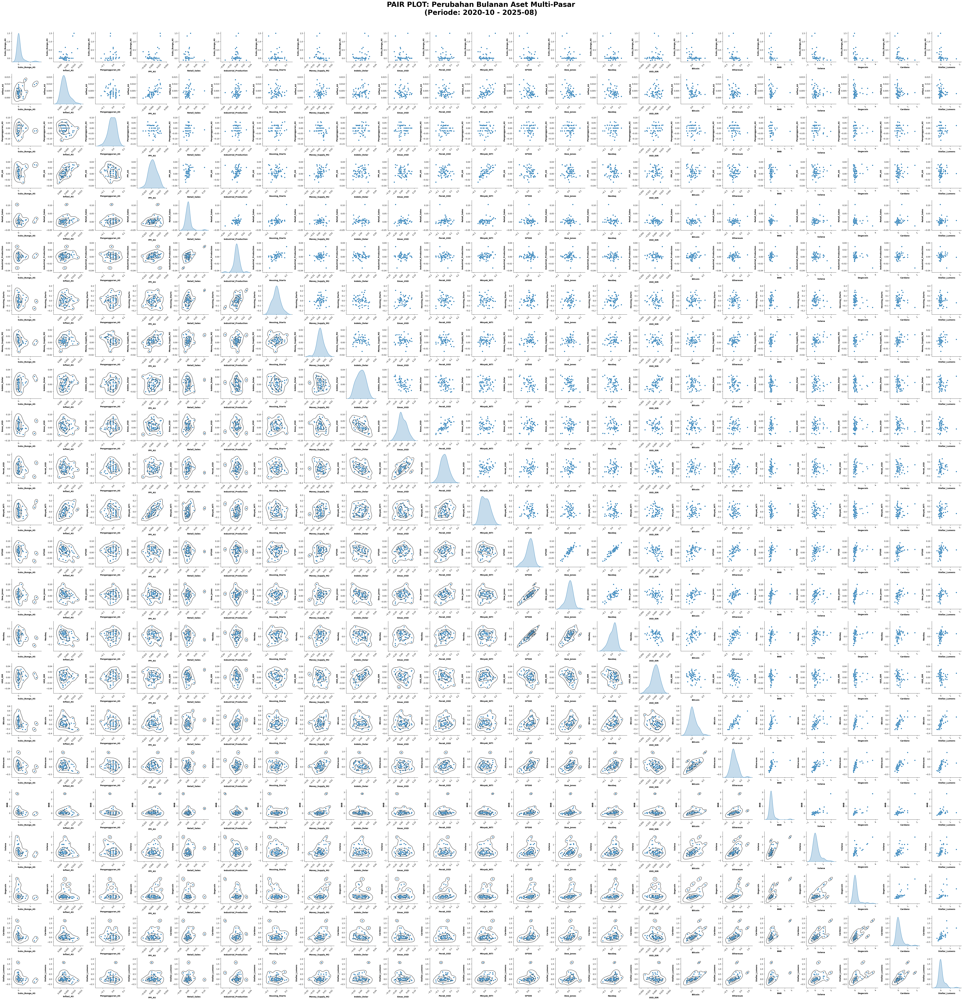

In [ ]:
print("=== PAIRPLOT PERUBAHAN BULANAN ===")

g = sns.pairplot(df_month_change, diag_kind="kde", height=3)

g.map_lower(sns.kdeplot, levels=4, color=".2")

g.fig.suptitle(f'PAIR PLOT: Perubahan Bulanan Aset Multi-Pasar\n(Periode: {periode_bulan_awal} - {periode_bulan_akhir})',
               fontsize=35,
               fontweight='bold',
               y=1.02)

rows, cols = g.axes.shape

for i in range(rows):
    for j in range(cols):
        ax = g.axes[i, j]

        xlabel_text = g.x_vars[j]
        ylabel_text = g.y_vars[i]

        ax.set_xlabel(xlabel_text, fontsize=10, fontweight='bold')
        ax.set_ylabel(ylabel_text, fontsize=10, fontweight='bold')

        ax.xaxis.label.set_visible(True)
        ax.yaxis.label.set_visible(True)

        ax.tick_params(labelbottom=True, labelleft=True)
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', rotation=0)

plt.subplots_adjust(wspace=0.4, hspace=0.4)

plt.savefig('pair_plot_bulanan.png', bbox_inches='tight', dpi=200)

plt.show()

In [ ]:
print("=== PAIRPLOT PERUBAHAN KUARTAL ===")

g = sns.pairplot(df_Q_change, diag_kind="kde", height=3)

g.map_lower(sns.kdeplot, levels=4, color=".2")

g.fig.suptitle(f'PAIR PLOT: Perubahan Kuartal Aset Multi-Pasar\n(Periode: {periode_kuartal_awal} - {periode_kuartal_akhir})',
               fontsize=35,
               fontweight='bold',
               y=1.02)

rows, cols = g.axes.shape

for i in range(rows):
    for j in range(cols):
        ax = g.axes[i, j]

        xlabel_text = g.x_vars[j]
        ylabel_text = g.y_vars[i]

        ax.set_xlabel(xlabel_text, fontsize=10, fontweight='bold')
        ax.set_ylabel(ylabel_text, fontsize=10, fontweight='bold')

        ax.xaxis.label.set_visible(True)
        ax.yaxis.label.set_visible(True)

        ax.tick_params(labelbottom=True, labelleft=True)
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='y', rotation=0)

plt.subplots_adjust(wspace=0.4, hspace=0.4)

plt.savefig('pair_plot_kuartal.png', bbox_inches='tight', dpi=200)

plt.show()

=== PAIRPLOT PERUBAHAN KUARTAL ===


# PUBLISHING

In [ ]:
df_daily_merge.to_csv('df_daily_raw.csv')
df_month_merge.to_csv('df_month_raw.csv')
df_Q_merge.to_csv('df_Q_raw.csv')

df_daily_clean.to_csv('df_daily_clean.csv')
df_month_clean.to_csv('df_month_clean.csv')
df_Q_clean.to_csv('df_Q_clean.csv')

In [ ]:
os.makedirs('data/raw', exist_ok=True)
os.makedirs('data/clean', exist_ok=True)

In [ ]:
source_dir ='.'

raw_dir = 'data/raw'
clean_dir = 'data/clean'

raw_csv_files = [
'df_daily_raw.csv',
'df_month_raw.csv',
'df_Q_raw.csv'

]

clean_csv_files = [
'df_daily_clean.csv',
'df_month_clean.csv',
'df_Q_clean.csv'

]

print(f"\nMemindahkan file dari '{source_dir}' ke '{raw_dir}' dan '{clean_dir}'  ")

for file in raw_csv_files:
  src_path = os.path.join(source_dir, file)
  dest_path = os.path.join(raw_dir, file)

  if os.path.exists(src_path):
    shutil.move(src_path, dest_path)
    print(f"\nMemindahkan {file} ke {raw_dir}")
  else:
    print(f"File {src_path} tidak ditemukan di skip")

for file in clean_csv_files:
  src_path = os.path.join(source_dir, file)
  dest_path = os.path.join(clean_dir, file)
  if os.path.exists(src_path):
    shutil.move(src_path, dest_path)
    print(f"\nMemindahkan {file} ke {clean_dir}")
  else:
    print(f"File {src_path} tidak ditemukan di skip")

print("SEMUA CSV sdh berhasil dipindahkan")


Memindahkan file dari '.' ke 'data/raw' dan 'data/clean'  

Memindahkan df_daily_raw.csv ke data/raw

Memindahkan df_month_raw.csv ke data/raw

Memindahkan df_Q_raw.csv ke data/raw

Memindahkan df_daily_clean.csv ke data/clean

Memindahkan df_month_clean.csv ke data/clean

Memindahkan df_Q_clean.csv ke data/clean
SEMUA CSV sdh berhasil dipindahkan


In [ ]:
os.makedirs('data/correlation_matrix', exist_ok=True)

os.makedirs('data/time_series', exist_ok=True)

os.makedirs('data/pair_plot', exist_ok=True)

os.makedirs('data/price_change', exist_ok=True)


In [ ]:
source_dir = '.'

correlation_matrix_dir = 'data/correlation_matrix'
time_series_dir = 'data/time_series'
pair_plot_dir = 'data/pair_plot'
price_change_dir = 'data/price_change'


correlation_matrix_files = [
    'correlation_matrix_daily.png',
    'correlation_matrix_monthly.png',
    'correlation_matrix_quarterly.png'
]

time_series_files = [
    'daily_time_series.png',
    'month_time_series.png',
    'Q_time_series.png'
]

pair_plot_files= [
    'pair_plot_harian.png',
    'pair_plot_bulanan.png',
    'pair_plot_kuartal.png'
]

prince_change_files = [
    'perubahan_harian.png',
    'perubahan_bulanan.png',
    'perubahan_kuartalan.png'
]

print(f"\nMemindahkan file dari '{source_dir}' ke '{correlation_matrix_dir}'")

for file in correlation_matrix_files:
    src_path = os.path.join(source_dir, file)
    dest_path = os.path.join(correlation_matrix_dir, file)
    if os.path.exists(src_path):
        shutil.move(src_path, dest_path)
        print(f"\nMemindahkan {file} ke {correlation_matrix_dir}")
    else:
        print(f"File {src_path} tidak ditemukan di skip")

print(f"\nMemindahkan file dari ''{source_dir}' ke '{time_series_dir}'")

for file in time_series_files:
    src_path = os.path.join(source_dir, file)
    dest_path = os.path.join(time_series_dir, file)
    if os.path.exists(src_path):
        shutil.move(src_path, dest_path)
        print(f"Memindahkan {file} ke {time_series_dir}")
    else:
        print(f"File {src_path} tidak ditemukan di skip")

for file in pair_plot_files:
    src_path = os.path.join(source_dir, file)
    dest_path = os.path.join(pair_plot_dir, file)
    if os.path.exists(src_path):
        shutil.move(src_path, dest_path)
        print(f"Memindahkan {file} ke {pair_plot_dir}")
    else:
        print(f"File {src_path} tidak ditemukan di skip")

for file in prince_change_files:
    src_path = os.path.join(source_dir, file)
    dest_path = os.path.join(price_change_dir, file)
    if os.path.exists(src_path):
        shutil.move(src_path, dest_path)
        print(f"Memindahkan {file} ke {price_change_dir}")
    else:
        print(f"File {src_path} tidak ditemukan di skip")

print("Semua PNG berhasil dipindahkan")


Memindahkan file dari '.' ke 'data/correlation_matrix'

Memindahkan correlation_matrix_daily.png ke data/correlation_matrix

Memindahkan correlation_matrix_monthly.png ke data/correlation_matrix

Memindahkan correlation_matrix_quarterly.png ke data/correlation_matrix

Memindahkan file dari ''.' ke 'data/time_series'
Memindahkan daily_time_series.png ke data/time_series
Memindahkan month_time_series.png ke data/time_series
Memindahkan Q_time_series.png ke data/time_series
Memindahkan pair_plot_harian.png ke data/pair_plot
Memindahkan pair_plot_bulanan.png ke data/pair_plot
Memindahkan pair_plot_kuartal.png ke data/pair_plot
Memindahkan perubahan_harian.png ke data/price_change
Memindahkan perubahan_bulanan.png ke data/price_change
Memindahkan perubahan_kuartalan.png ke data/price_change
Semua PNG berhasil dipindahkan


In [ ]:
shutil.make_archive('output', 'zip', 'data')

'/content/output.zip'